# Rain Forecasting 

### The Rain Forecasting Project aims to predict whether it will rain the next day based on historical weather data. By analyzing key meteorological features such as temperature, humidity, wind patterns, and atmospheric pressure, the project leverages machine learning models to make accurate predictions. This forecasting system can assist farmers, travelers, and weather agencies in making informed decisions. The primary objective is to improve weather prediction accuracy using data-driven insights.

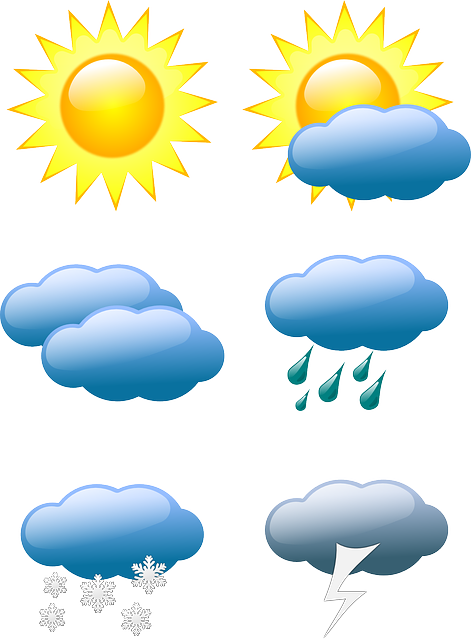

## Problem Statement

This project aims to develop a robust rain forecasting model that predicts whether it will rain the following day using historical weather data. By analyzing key meteorological factors such as temperature, humidity, wind conditions, and atmospheric pressure, the model will provide accurate predictions. The goal is to enhance weather forecasting capabilities, enabling better planning and decision-making for agriculture, travel, and public safety. The solution will be built using data preprocessing, feature engineering, and machine learning techniques to achieve optimal performance.

## Project Aim

### 1 Accurate Prediction:
Develop a machine learning model to accurately predict whether it will rain the next day using historical weather data.
### 2 Feature Analysis: 
Identify the most influential weather features that contribute to rainfall prediction for improved model performance.
### 3 Decision Support: 
Provide a reliable tool to assist farmers, travelers, and weather agencies in planning and risk management.

# Importing Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import warnings
warnings.filterwarnings("ignore")

In [2]:
df=pd.read_csv('Rain.csv')
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


Date: The date of observation.

Location: The location where weather data was recorded.

MinTemp: Minimum temperature of the day (°C).

MaxTemp: Maximum temperature of the day (°C).

Rainfall: Amount of rainfall recorded in mm.

Evaporation: Amount of water evaporated in mm (pan evaporation).

Sunshine: Number of hours of sunshine recorded.

WindGustDir: Direction of the strongest gust of wind.

WindGustSpeed: Speed of the strongest gust of wind in km/h.

WindDir9am: Direction of wind at 9 am.

WindDir3pm: Direction of wind at 3 pm.

WindSpeed9am: Wind speed at 9 am in km/h.

WindSpeed3pm: Wind speed at 3 pm in km/h.

Humidity9am: Humidity at 9 am as a percentage.

Humidity3pm: Humidity at 3 pm as a percentage.

Pressure9am: Atmospheric pressure at 9 am in hPa.

Pressure3pm: Atmospheric pressure at 3 pm in hPa.

Cloud9am: Cloud cover at 9 am (measured in oktas).

Cloud3pm: Cloud cover at 3 pm (measured in oktas).

Temp9am: Temperature at 9 am in °C.

Temp3pm: Temperature at 3 pm in °C.

RainToday: Whether it rained today ('Yes' or 'No').

RainTomorrow (Target Column): Whether it will rain tomorrow ('Yes' or 'No').


# Basic Checks 

In [3]:
df.shape

(145460, 23)

### There are 145460 rows and 23 columns

In [4]:
df.dtypes

Date              object
Location          object
MinTemp          float64
MaxTemp          float64
Rainfall         float64
Evaporation      float64
Sunshine         float64
WindGustDir       object
WindGustSpeed    float64
WindDir9am        object
WindDir3pm        object
WindSpeed9am     float64
WindSpeed3pm     float64
Humidity9am      float64
Humidity3pm      float64
Pressure9am      float64
Pressure3pm      float64
Cloud9am         float64
Cloud3pm         float64
Temp9am          float64
Temp3pm          float64
RainToday         object
RainTomorrow      object
dtype: object

### All the columns have either object or float as their datatype

In [5]:
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No


### First 5 rows 

In [6]:
df.tail()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No
145459,2017-06-25,Uluru,14.9,NaN,0.0,NaN,NaN,NaN,NaN,ESE,...,62.0,36.0,1020.2,1017.9,8.0,8.0,15.0,20.9,No,NaN


### Last 5 rows 

In [7]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

### The types of columns in the dataset

In [8]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 145460 entries, 0 to 145459
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           145460 non-null  object 
 1   Location       145460 non-null  object 
 2   MinTemp        143975 non-null  float64
 3   MaxTemp        144199 non-null  float64
 4   Rainfall       142199 non-null  float64
 5   Evaporation    82670 non-null   float64
 6   Sunshine       75625 non-null   float64
 7   WindGustDir    135134 non-null  object 
 8   WindGustSpeed  135197 non-null  float64
 9   WindDir9am     134894 non-null  object 
 10  WindDir3pm     141232 non-null  object 
 11  WindSpeed9am   143693 non-null  float64
 12  WindSpeed3pm   142398 non-null  float64
 13  Humidity9am    142806 non-null  float64
 14  Humidity3pm    140953 non-null  float64
 15  Pressure9am    130395 non-null  float64
 16  Pressure3pm    130432 non-null  float64
 17  Cloud9am       89572 non-null

### The general information regarding the non null value counts and the datatypes

In [9]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
MinTemp,143975.0,12.194034,6.398495,-8.5,7.6,12.0,16.9,33.9
MaxTemp,144199.0,23.221348,7.119049,-4.8,17.9,22.6,28.2,48.1
Rainfall,142199.0,2.360918,8.478060,0.0,0.0,0.0,0.8,371.0
Evaporation,82670.0,5.468232,4.193704,0.0,2.6,4.8,7.4,145.0
Sunshine,75625.0,7.611178,3.785483,0.0,4.8,8.4,10.6,14.5
WindGustSpeed,135197.0,40.035230,13.607062,6.0,31.0,39.0,48.0,135.0
WindSpeed9am,143693.0,14.043426,8.915375,0.0,7.0,13.0,19.0,130.0
WindSpeed3pm,142398.0,18.662657,8.809800,0.0,13.0,19.0,24.0,87.0
Humidity9am,142806.0,68.880831,19.029164,0.0,57.0,70.0,83.0,100.0
Humidity3pm,140953.0,51.539116,20.795902,0.0,37.0,52.0,66.0,100.0


# Insights
1. MinTemp : The minimum Temperature is -8.5 and goes upto 33.9 degrees
2. MaxTemp : The maximum Temperature goes from -4.8 to 48.1 degrees
3. The windspeed decreases effectively from 9am to 3 pm
4. Temp9am : The maximum temperature at that time is 40.2 degrees
5. Temp3pm : The maximum temperature is 46.7 degrees

In [10]:
num_data = df.select_dtypes(include=["float64","int64"])
print("numerical columns",num_data.columns)

numerical columns Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')


### These are the numerical columns in the data

In [11]:
cat_data=df.select_dtypes(include=["O"])
print("categorical columns",cat_data.columns)

categorical columns Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')


### These are the categorical columns in the data 

In [12]:
for i in cat_data:
  print(i,df[i].unique())
  print(df[i].value_counts())
  print("**********************")

Date ['2008-12-01' '2008-12-02' '2008-12-03' ... '2008-01-29' '2008-01-30'
 '2008-01-31']
Date
2013-11-12    49
2014-09-01    49
2014-08-23    49
2014-08-24    49
2014-08-25    49
              ..
2007-11-29     1
2007-11-28     1
2007-11-27     1
2007-11-26     1
2008-01-31     1
Name: count, Length: 3436, dtype: int64
**********************
Location ['Albury' 'BadgerysCreek' 'Cobar' 'CoffsHarbour' 'Moree' 'Newcastle'
 'NorahHead' 'NorfolkIsland' 'Penrith' 'Richmond' 'Sydney' 'SydneyAirport'
 'WaggaWagga' 'Williamtown' 'Wollongong' 'Canberra' 'Tuggeranong'
 'MountGinini' 'Ballarat' 'Bendigo' 'Sale' 'MelbourneAirport' 'Melbourne'
 'Mildura' 'Nhil' 'Portland' 'Watsonia' 'Dartmoor' 'Brisbane' 'Cairns'
 'GoldCoast' 'Townsville' 'Adelaide' 'MountGambier' 'Nuriootpa' 'Woomera'
 'Albany' 'Witchcliffe' 'PearceRAAF' 'PerthAirport' 'Perth' 'SalmonGums'
 'Walpole' 'Hobart' 'Launceston' 'AliceSprings' 'Darwin' 'Katherine'
 'Uluru']
Location
Canberra            3436
Sydney              3344
Darwin

### This is the value counts of all the categorical columns 

# EDA (Exploratory Data Analysis)

## Univariant Analysis 

In [13]:
import ydata_profiling as pp
pp.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

### The report shows that there are 10.3% of missing cells and no duplicate values

In [14]:
x=df['RainTomorrow']

In [15]:
countplot_1 = sns.countplot(x=df["RainTomorrow"])
count= df.RainTomorrow.value_counts()
print(count)

RainTomorrow
No     110316
Yes     31877
Name: count, dtype: int64


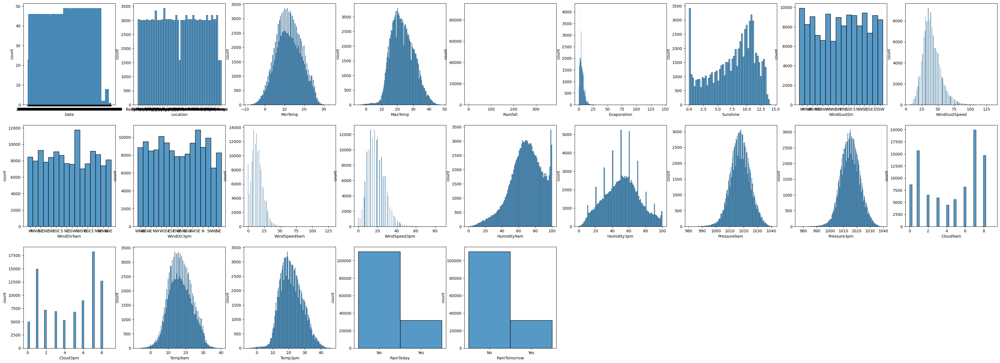

In [17]:
plt.figure(figsize=(45,50),facecolor='white')
plotnumber=1

for column in df:
  if plotnumber<=81:
    ax=plt.subplot(9,9,plotnumber)
    sns.histplot(x=df[column])
    plt.xlabel(column,fontsize=10)
    plt.ylabel("count",fontsize=10)
  plotnumber+=1
plt.show()

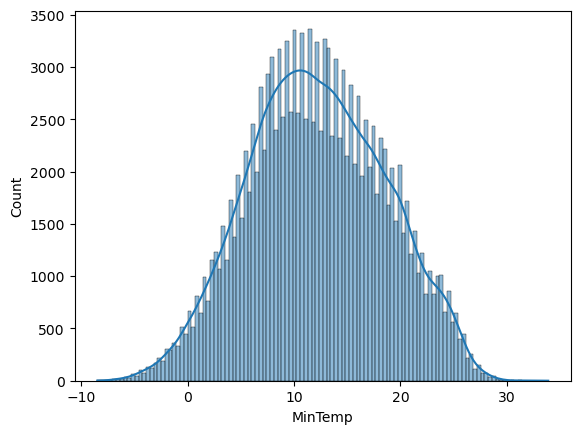

In [18]:
sns.histplot(x=df['MinTemp'],kde=True)
plt.show()

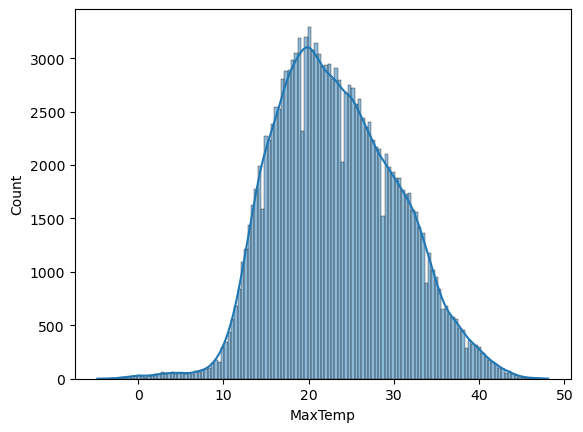

In [19]:
sns.histplot(x=df['MaxTemp'],kde=True)
plt.show()

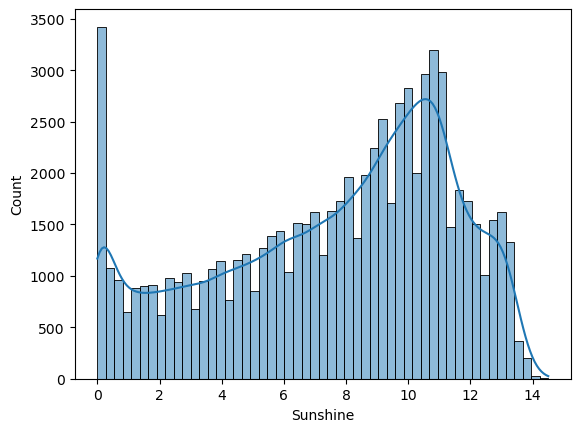

In [21]:
sns.histplot(x=df['Sunshine'],kde=True)
plt.show()

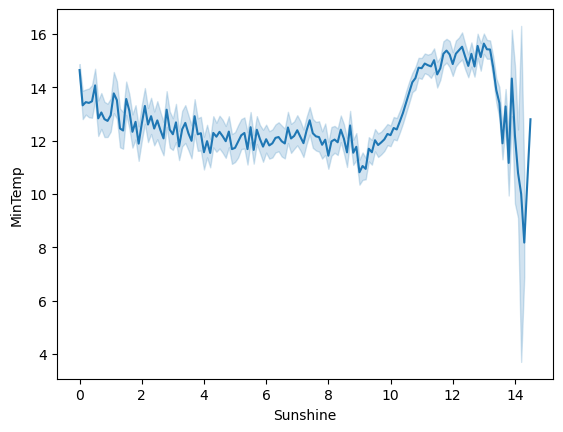

In [25]:
sns.lineplot(x=df['Sunshine'],y=df['MinTemp'])
plt.show()

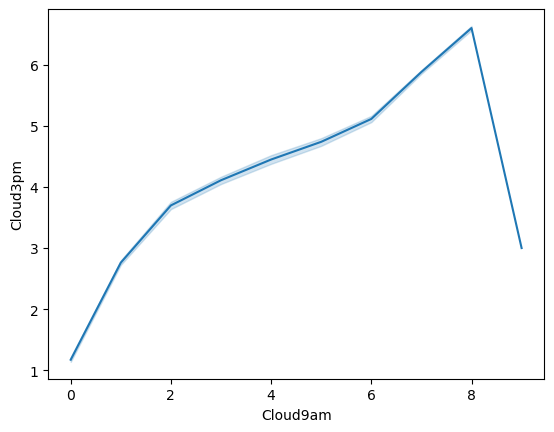

In [27]:
sns.lineplot(x=df['Cloud9am'],y=df['Cloud3pm'])
plt.show()

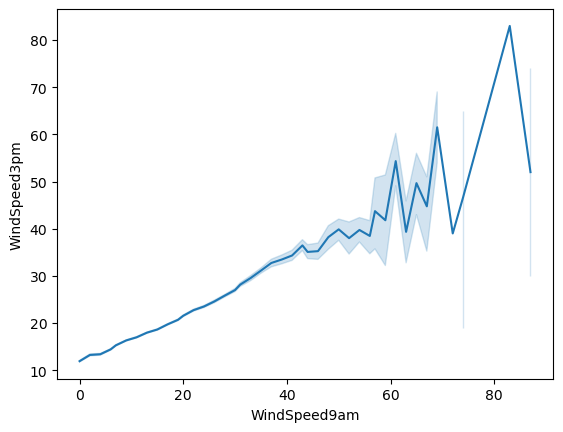

In [29]:
sns.lineplot(x=df['WindSpeed9am'],y=df['WindSpeed3pm'])
plt.show()

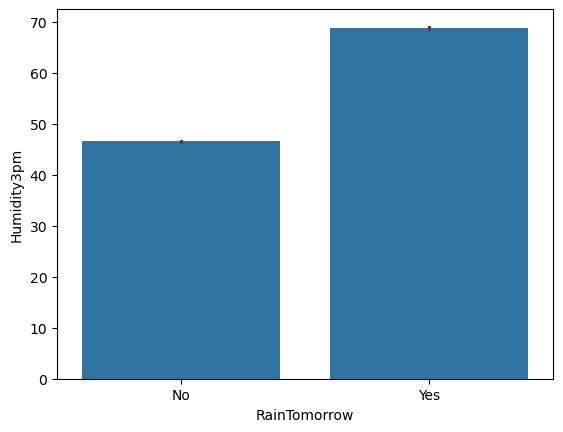

In [32]:
sns.barplot(x=df['RainTomorrow'],y=df['Humidity3pm'])
plt.show()

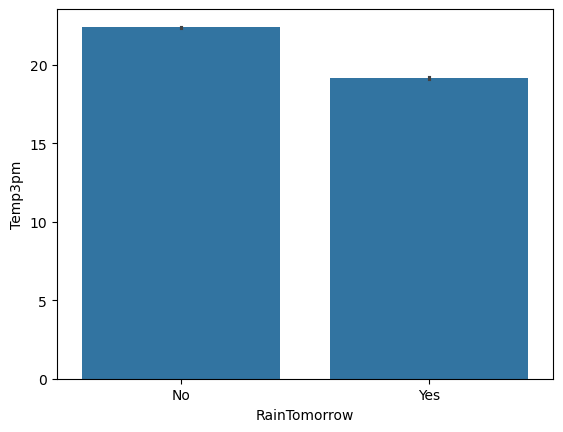

In [34]:
sns.barplot(x=df['RainTomorrow'],y=df['Temp3pm'])
plt.show()

## Bivariate Analysis 

In [35]:
cat_data.columns

Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')

In [36]:
d1=df[['WindGustDir', 'WindDir9am', 'WindDir3pm','RainToday', 'RainTomorrow']]

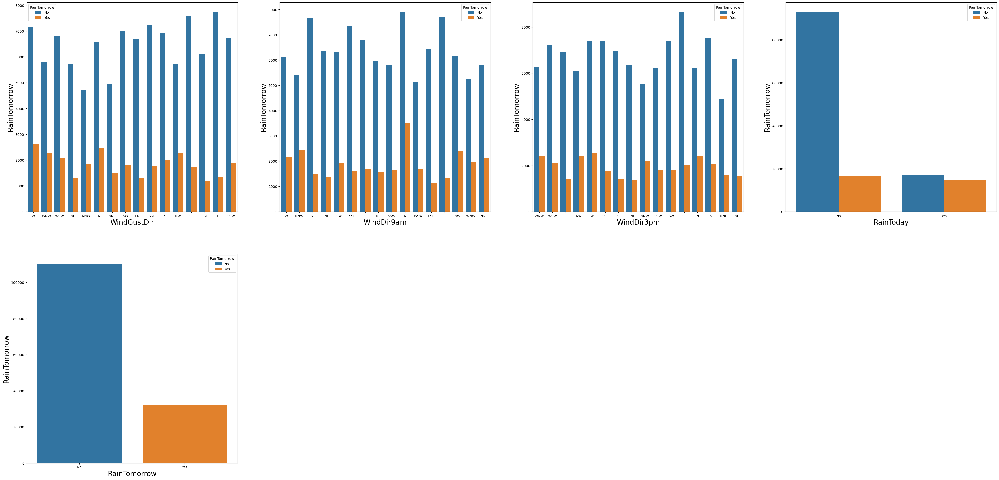

In [37]:
# Plotting how every  categorical feature correlate with the "target"
plt.figure(figsize=(50,50), facecolor='white')
plotnumber = 1

for column in d1:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.countplot(x=d1[column]           
                        ,hue=df.RainTomorrow)
        plt.xlabel(column,fontsize=20)
        plt.ylabel('RainTomorrow',fontsize=20) 
    plotnumber+=1
plt.show()

### Plotting every categorical column with the target

## Insights from Categorical data 
1. WindGustDir : It shows that the wind direction is the fastest in the east path
2. WindDir9am : At 9 am the wind is highest in the north direction and the lowest in the west south west direction
3. WindDir3pm : At 3 pm the wind is highest in the south east direction and the lowest in the northern north east direction

In [38]:
num_data.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

In [39]:
d2=df[['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm']]

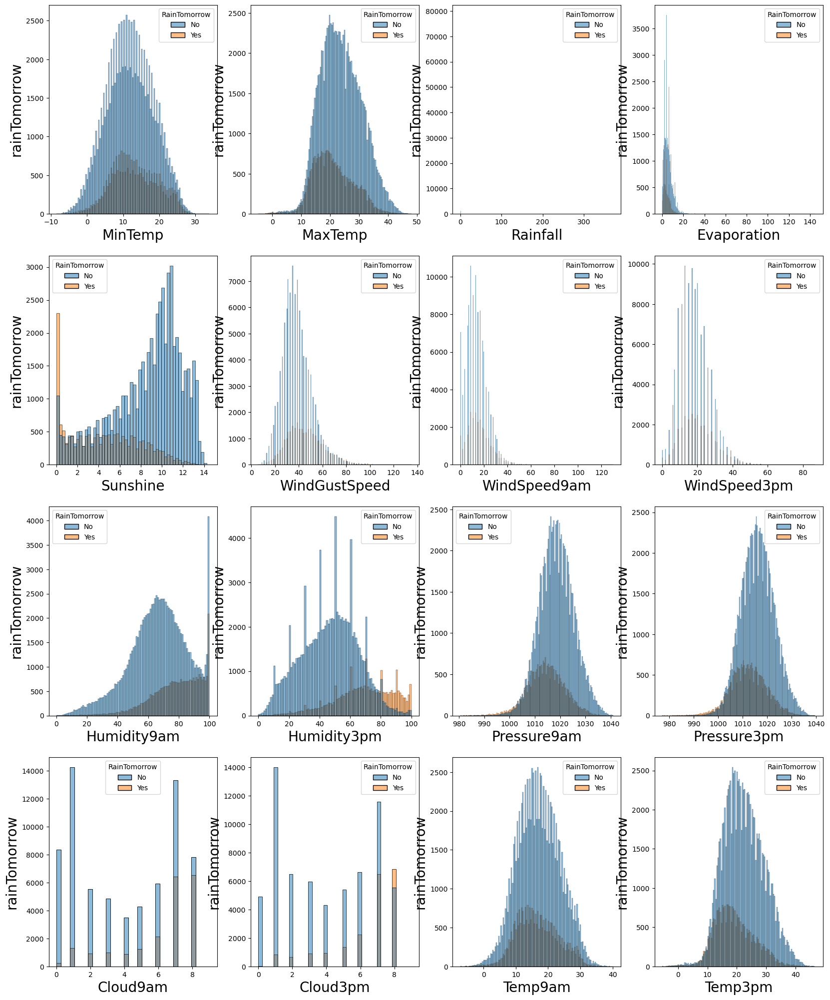

In [40]:
# Plotting how every  numerical feature correlate with the "target"
plt.figure(figsize=(20,25), facecolor='white')
plotnumber = 1

for column in d2:
    if plotnumber<=16 :
        ax = plt.subplot(4,4,plotnumber)
        sns.histplot(x=d2[column]         
                        ,hue=df.RainTomorrow)
        plt.xlabel(column,fontsize=20)
        plt.ylabel('rainTomorrow',fontsize=20)
    plotnumber+=1
plt.show()

## Insights from the numerical data 
1. The wind speed at 3pm is more dense than the speed at 9 am which shows that wind speed is higher in the afternoon
2. The humidity at 3 pm increases rapidly at some points whereas at 9 am it increases only at the end
3. The pressure at 9 am is more fluctuating then 3 pm hence the pressure is more in the morning
4. The cloud density at 3 pm shows that there are chances of rainfall the next day
5. The temperature at 9 am is increasing and then decreasing and is less intense than the temperature at 3 pm . the temperature at 9 am depicts the min temperature and the temp at 3 pm indicates the max temp graph .

# Data Preprocessing 

In [42]:
df.isnull().sum()

Date                 0
Location             0
MinTemp           1485
MaxTemp           1261
Rainfall          3261
Evaporation      62790
Sunshine         69835
WindGustDir      10326
WindGustSpeed    10263
WindDir9am       10566
WindDir3pm        4228
WindSpeed9am      1767
WindSpeed3pm      3062
Humidity9am       2654
Humidity3pm       4507
Pressure9am      15065
Pressure3pm      15028
Cloud9am         55888
Cloud3pm         59358
Temp9am           1767
Temp3pm           3609
RainToday         3261
RainTomorrow      3267
dtype: int64

In [43]:
missing_percentage = (df.isnull().sum() / len(df)) * 100
print(missing_percentage)

Date              0.000000
Location          0.000000
MinTemp           1.020899
MaxTemp           0.866905
Rainfall          2.241853
Evaporation      43.166506
Sunshine         48.009762
WindGustDir       7.098859
WindGustSpeed     7.055548
WindDir9am        7.263853
WindDir3pm        2.906641
WindSpeed9am      1.214767
WindSpeed3pm      2.105046
Humidity9am       1.824557
Humidity3pm       3.098446
Pressure9am      10.356799
Pressure3pm      10.331363
Cloud9am         38.421559
Cloud3pm         40.807095
Temp9am           1.214767
Temp3pm           2.481094
RainToday         2.241853
RainTomorrow      2.245978
dtype: float64


## Not replacing columns with percentage more than 40 % and dropping them ahead

# Handling missing values 

In [44]:
num_data.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

In [45]:
cat_data.columns

Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')

In [46]:
df.loc[df['MinTemp'].isnull()==True,'MinTemp']=df['MinTemp'].median()
df.loc[df['MaxTemp'].isnull()==True,'MaxTemp']=df['MaxTemp'].median()
df.loc[df['Rainfall'].isnull()==True,'Rainfall']=df['Rainfall'].median()
df.loc[df['WindGustSpeed'].isnull()==True,'WindGustSpeed']=df['WindGustSpeed'].median()
df.loc[df['WindSpeed9am'].isnull()==True,'WindSpeed9am']=df['WindSpeed9am'].median()
df.loc[df['WindSpeed3pm'].isnull()==True,'WindSpeed3pm']=df['WindSpeed3pm'].median()
df.loc[df['Humidity9am'].isnull()==True,'Humidity9am']=df['Humidity9am'].median()
df.loc[df['Humidity3pm'].isnull()==True,'Humidity3pm']=df['Humidity3pm'].median()
df.loc[df['Pressure9am'].isnull()==True,'Pressure9am']=df['Pressure9am'].median()
df.loc[df['Pressure3pm'].isnull()==True,'Pressure3pm']=df['Pressure3pm'].median()
df.loc[df['Cloud9am'].isnull()==True,'Cloud9am']=df['Cloud9am'].median()
df.loc[df['Cloud3pm'].isnull()==True,'Cloud3pm']=df['Cloud3pm'].median()
df.loc[df['Temp9am'].isnull()==True,'Temp9am']=df['Temp9am'].median()
df.loc[df['Temp3pm'].isnull()==True,'Temp3pm']=df['Temp3pm'].median()

## Handled the missing values of the numerical columns with the help of median

In [47]:
df['WindGustDir'].fillna(df['WindGustDir'].mode()[0], inplace=True)
df['WindDir9am'].fillna(df['WindDir9am'].mode()[0], inplace=True)
df['WindDir3pm'].fillna(df['WindDir3pm'].mode()[0], inplace=True)
df['RainToday'].fillna(df['RainToday'].mode()[0], inplace=True)
df['RainTomorrow'].fillna(df['RainTomorrow'].mode()[0], inplace=True)

## handled the missing values of the categorical columns with the help of mode 

In [48]:
df.isnull().sum()

Date                 0
Location             0
MinTemp              0
MaxTemp              0
Rainfall             0
Evaporation      62790
Sunshine         69835
WindGustDir          0
WindGustSpeed        0
WindDir9am           0
WindDir3pm           0
WindSpeed9am         0
WindSpeed3pm         0
Humidity9am          0
Humidity3pm          0
Pressure9am          0
Pressure3pm          0
Cloud9am             0
Cloud3pm             0
Temp9am              0
Temp3pm              0
RainToday            0
RainTomorrow         0
dtype: int64

## All the relevant missing values have been imputed

# Check for outliers 

In [49]:
num_data

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm
0,13.4,22.9,0.6,NaN,NaN,44.0,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8
1,7.4,25.1,0.0,NaN,NaN,44.0,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3
2,12.9,25.7,0.0,NaN,NaN,46.0,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2
3,9.2,28.0,0.0,NaN,NaN,24.0,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5
4,17.5,32.3,1.0,NaN,NaN,41.0,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2.8,23.4,0.0,NaN,NaN,31.0,13.0,11.0,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4
145456,3.6,25.3,0.0,NaN,NaN,22.0,13.0,9.0,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5
145457,5.4,26.9,0.0,NaN,NaN,37.0,9.0,9.0,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1
145458,7.8,27.0,0.0,NaN,NaN,28.0,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0


In [50]:
num_data.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

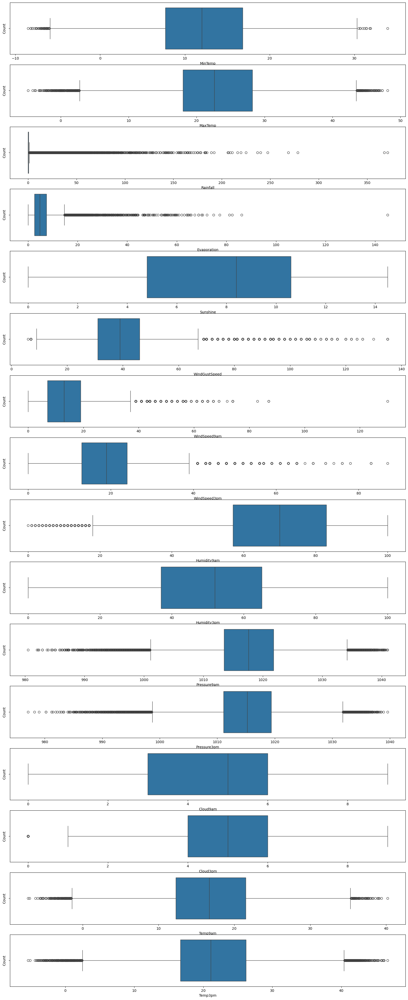

In [51]:
plt.figure(figsize=(20,50),facecolor='white')
plotnumber=1

for column in num_data:
  if plotnumber<=16:
    ax=plt.subplot(16,1,plotnumber)
    sns.boxplot(x=df[column])
    plt.xlabel(column,fontsize=10)
    plt.ylabel('Count',fontsize=10)
  plotnumber+=1
plt.show()

## We can see outliers in most of the columns , so we replace them because during the time of training and testing they can cause overfitting or underfitting of the model

### using IQR method to remove outliers 

In [52]:

columns_to_analyze = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm']

for column in columns_to_analyze:
    Q1 = df[column].quantile(0.25)
    Q3 = df[column].quantile(0.75)
    IQR = Q3 - Q1
    lower_limit = Q1 - 1.5 * IQR
    upper_limit = Q3 + 1.5 * IQR


    lower_outliers = len(df.loc[df[column] < lower_limit])
    upper_outliers = len(df.loc[df[column] > upper_limit])
    total_outliers = lower_outliers + upper_outliers
    total_records = len(df)

    print(f"Column: {column}")
    print(f"IQR: {IQR}")
    print(f"Lower Limit: {lower_limit}")
    print(f"Upper Limit: {upper_limit}")
    print(f"Percentage of Lower Outliers: {(lower_outliers / total_records) * 100}%")
    print(f"Percentage of Upper Outliers: {(upper_outliers / total_records) * 100}%")
    print(f"Total Outliers: {total_outliers}\n")


Column: MinTemp
IQR: 9.100000000000001
Lower Limit: -5.950000000000002
Upper Limit: 30.450000000000003
Percentage of Lower Outliers: 0.04881066959989001%
Percentage of Upper Outliers: 0.0075622164168843665%
Total Outliers: 82

Column: MaxTemp
IQR: 10.2
Lower Limit: 2.700000000000001
Upper Limit: 43.5
Percentage of Lower Outliers: 0.2474907190980338%
Percentage of Upper Outliers: 0.12649525642788395%
Total Outliers: 544

Column: Rainfall
IQR: 0.6
Lower Limit: -0.8999999999999999
Upper Limit: 1.5
Percentage of Lower Outliers: 0.0%
Percentage of Upper Outliers: 19.894128970163617%
Total Outliers: 28938

Column: Evaporation
IQR: 4.800000000000001
Lower Limit: -4.600000000000001
Upper Limit: 14.600000000000001
Percentage of Lower Outliers: 0.0%
Percentage of Upper Outliers: 1.3715110683349374%
Total Outliers: 1995

Column: Sunshine
IQR: 5.8
Lower Limit: -3.8999999999999995
Upper Limit: 19.299999999999997
Percentage of Lower Outliers: 0.0%
Percentage of Upper Outliers: 0.0%
Total Outliers: 0

In [53]:
Q1=df['MinTemp'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['MinTemp'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['MinTemp']>upper_limit]
df.loc[df['MinTemp']<lower_limit]

df.loc[df['MinTemp']<lower_limit,"MinTemp"] =df["MinTemp"].median()
df.loc[df['MinTemp']>upper_limit,"MinTemp"] =df["MinTemp"].median()

lower quartile 7.7
upper quartile 16.8
9.100000000000001
lower limit is -5.950000000000002
upper_limit is 30.450000000000003


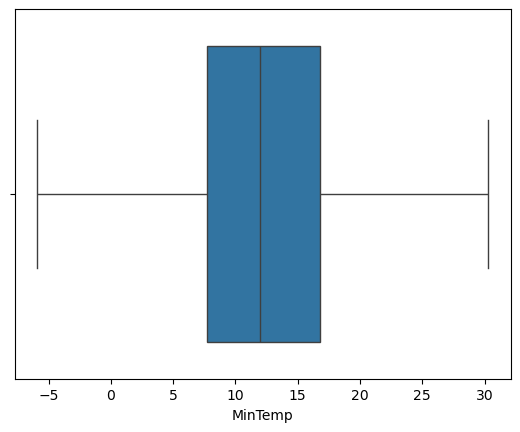

In [54]:
sns.boxplot(x=df['MinTemp'])
plt.show()

In [57]:
Q1=df['MaxTemp'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['MaxTemp'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['MaxTemp']>upper_limit]
df.loc[df['MaxTemp']<lower_limit]

df.loc[df['MaxTemp']<lower_limit,"MaxTemp"]=df["MaxTemp"].median()
df.loc[df['MaxTemp']>upper_limit,"MaxTemp"]=df["MaxTemp"].median()

lower quartile 18.0
upper quartile 28.1
10.100000000000001
lower limit is 2.849999999999998
upper_limit is 43.25


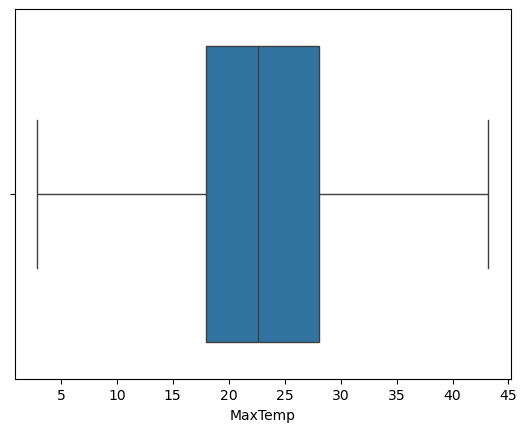

In [58]:
sns.boxplot(x=df['MaxTemp'])
plt.show()

In [62]:
Q1=df['Rainfall'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Rainfall'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Rainfall']>upper_limit]
df.loc[df['Rainfall']<lower_limit]

df.loc[df['Rainfall']>upper_limit,"Rainfall"]=df["Rainfall"].median()
df.loc[df['MaxTemp']<lower_limit,"MaxTemp"]=df["MaxTemp"].median()

lower quartile 0.0
upper quartile 0.0
0.0
lower limit is 0.0
upper_limit is 0.0


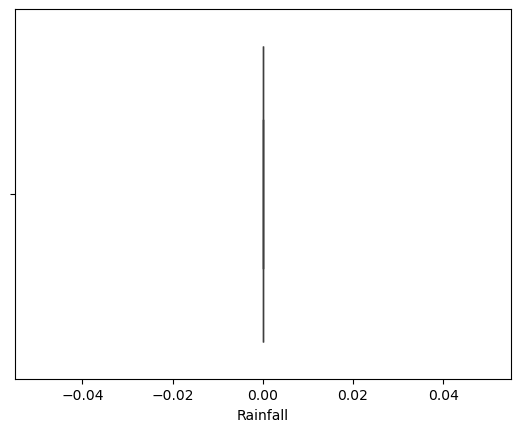

In [63]:
sns.boxplot(x=df['Rainfall'])
plt.show()

In [66]:
Q1=df['WindGustSpeed'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['WindGustSpeed'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['WindGustSpeed']>upper_limit]
df.loc[df['WindGustSpeed']<lower_limit]

df.loc[df['WindGustSpeed']>upper_limit,"WindGustSpeed"]=df["WindGustSpeed"].median()
df.loc[df['WindGustSpeed']<lower_limit,"WindGustSpeed"]=df["WindGustSpeed"].median()

lower quartile 31.0
upper quartile 44.0
13.0
lower limit is 11.5
upper_limit is 63.5


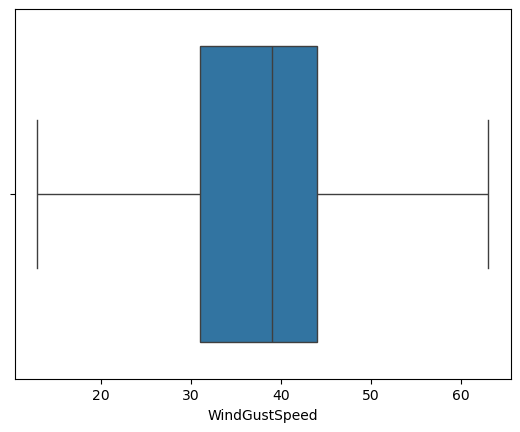

In [67]:
sns.boxplot(x=df['WindGustSpeed'])
plt.show()

In [70]:
Q1=df['Humidity9am'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Humidity9am'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Humidity9am']>upper_limit]
df.loc[df['Humidity9am']<lower_limit]

df.loc[df['Humidity9am']>upper_limit,"Humidity9am"]=df["Humidity9am"].median()
df.loc[df['Humidity9am']<lower_limit,"Humidity9am"]=df["Humidity9am"].median()

lower quartile 58.0
upper quartile 83.0
25.0
lower limit is 20.5
upper_limit is 120.5


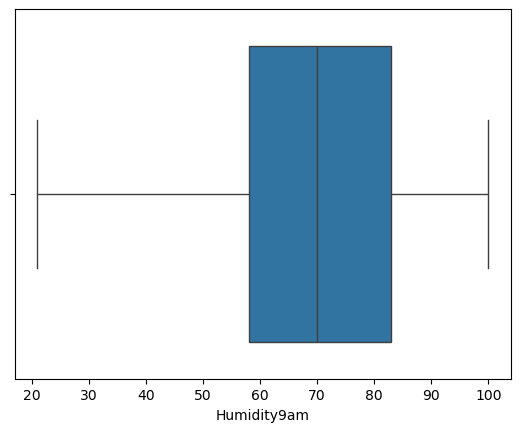

In [71]:
sns.boxplot(x=df['Humidity9am'])
plt.show()

In [72]:
Q1=df['WindSpeed9am'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['WindSpeed9am'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['WindSpeed9am']>upper_limit]
df.loc[df['WindSpeed9am']<lower_limit]

df.loc[df['WindSpeed9am']>upper_limit,"WindSpeed9am"]=df["WindSpeed9am"].median()

lower quartile 7.0
upper quartile 19.0
12.0
lower limit is -11.0
upper_limit is 37.0


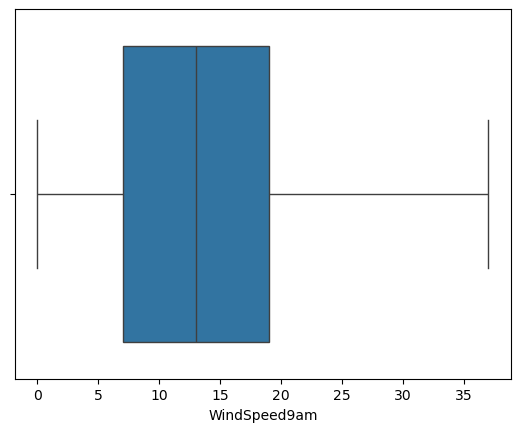

In [73]:
sns.boxplot(x=df['WindSpeed9am'])
plt.show()

In [74]:
Q1=df['WindSpeed3pm'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['WindSpeed3pm'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['WindSpeed3pm']>upper_limit]
df.loc[df['WindSpeed3pm']<lower_limit]

df.loc[df['WindSpeed3pm']>upper_limit,"WindSpeed3pm"]=df["WindSpeed3pm"].median()

lower quartile 13.0
upper quartile 24.0
11.0
lower limit is -3.5
upper_limit is 40.5


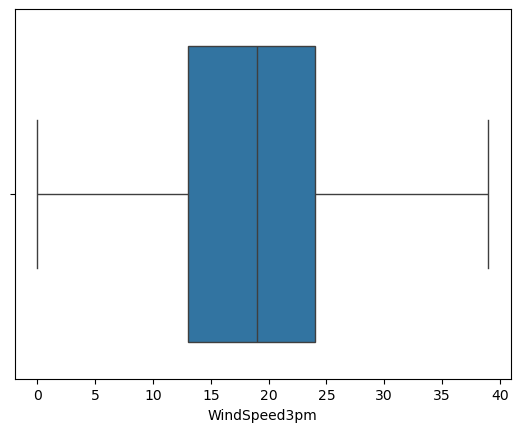

In [75]:
sns.boxplot(x=df['WindSpeed3pm'])
plt.show()

In [80]:
Q1=df['Pressure9am'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Pressure9am'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Pressure9am']>upper_limit]
df.loc[df['Pressure9am']<lower_limit]

df.loc[df['Pressure9am']>upper_limit,"Pressure9am"]=df["Pressure9am"].median()
df.loc[df['Pressure9am']<lower_limit,"Pressure9am"]=df["Pressure9am"].median()

lower quartile 1013.9
upper quartile 1021.5
7.600000000000023
lower limit is 1002.5
upper_limit is 1032.9


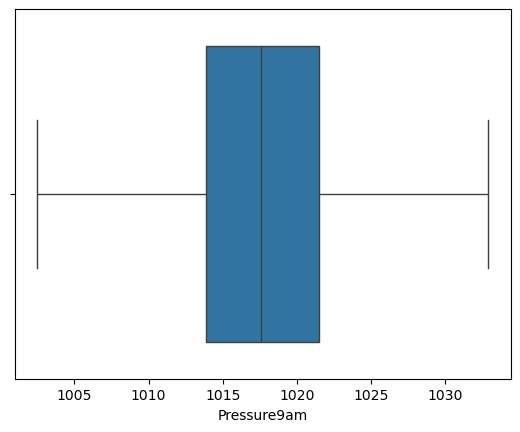

In [81]:
sns.boxplot(x=df['Pressure9am'])
plt.show()

In [86]:
Q1=df['Pressure3pm'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Pressure3pm'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Pressure3pm']>upper_limit]
df.loc[df['Pressure3pm']<lower_limit]

df.loc[df['Pressure3pm']>upper_limit,"Pressure3pm"]=df["Pressure3pm"].median()
df.loc[df['Pressure3pm']<lower_limit,"Pressure3pm"]=df["Pressure3pm"].median()

lower quartile 1011.3
upper quartile 1019.1
7.800000000000068
lower limit is 999.5999999999999
upper_limit is 1030.8000000000002


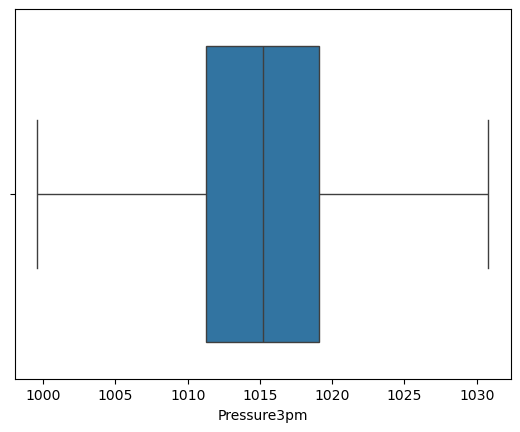

In [87]:
sns.boxplot(x=df['Pressure3pm'])
plt.show()

In [88]:
Q1=df['Cloud3pm'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Cloud3pm'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Cloud3pm']>upper_limit]
df.loc[df['Cloud3pm']<lower_limit]

df.loc[df['Cloud3pm']>upper_limit,"Cloud3pm"]=df["Cloud3pm"].median()

lower quartile 4.0
upper quartile 6.0
2.0
lower limit is 1.0
upper_limit is 9.0


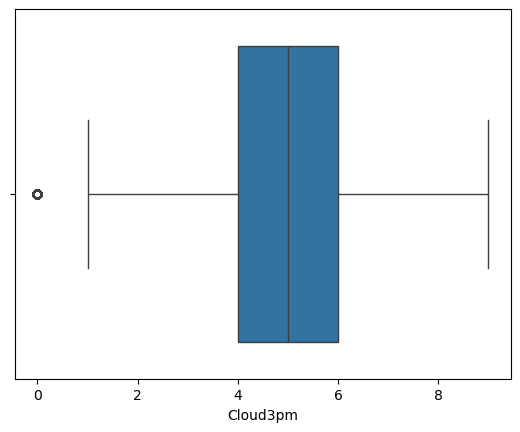

In [89]:
sns.boxplot(x=df['Cloud3pm'])
plt.show()

In [92]:
Q1=df['Temp9am'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Temp9am'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Temp9am']>upper_limit]
df.loc[df['Temp9am']<lower_limit]

df.loc[df['Temp9am']>upper_limit,"Temp9am"]=df["Temp9am"].median()
df.loc[df['Temp9am']<lower_limit,"Temp9am"]=df["Temp9am"].median()

lower quartile 12.4
upper quartile 21.5
9.1
lower limit is -1.2499999999999982
upper_limit is 35.15


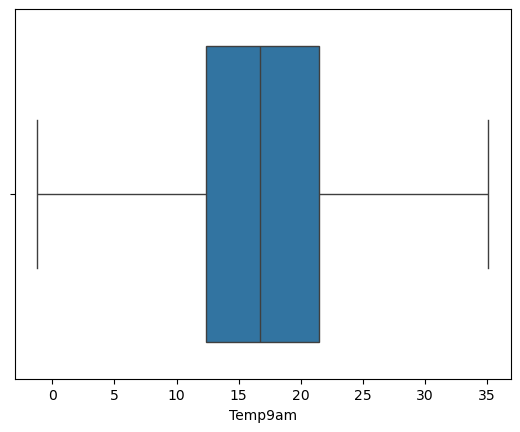

In [93]:
sns.boxplot(x=df['Temp9am'])
plt.show()

In [96]:
Q1=df['Temp3pm'].quantile(0.25)
print("lower quartile",Q1)
Q3=df['Temp3pm'].quantile(0.75)
print("upper quartile",Q3)
IQR=Q3-Q1
print(IQR)

lower_limit=Q1-1.5*IQR
print("lower limit is",lower_limit)
upper_limit=Q3+1.5*IQR
print("upper_limit is",upper_limit)

df.loc[df['Temp3pm']>upper_limit]
df.loc[df['Temp3pm']<lower_limit]

df.loc[df['Temp3pm']>upper_limit,"Temp3pm"]=df["Temp3pm"].median()
df.loc[df['Temp3pm']<lower_limit,"Temp3pm"]=df["Temp3pm"].median()

lower quartile 16.8
upper quartile 26.2
9.399999999999999
lower limit is 2.700000000000003
upper_limit is 40.3


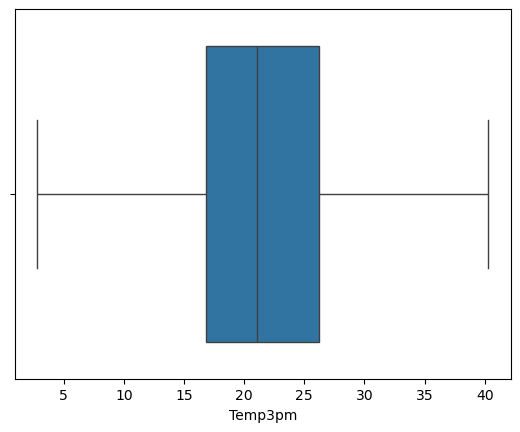

In [97]:
sns.boxplot(x=df['Temp3pm'])
plt.show()

### Now there are no outliers in any of the numeric columns 

## Converting categorical columns to numerical colums

In [98]:
cat_data.columns

Index(['Date', 'Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm',
       'RainToday', 'RainTomorrow'],
      dtype='object')

In [99]:
from sklearn.preprocessing import LabelEncoder
lc=LabelEncoder()
df.WindGustDir=lc.fit_transform(df.WindGustDir)
df.WindDir9am=lc.fit_transform(df.WindDir9am)
df.WindDir3pm=lc.fit_transform(df.WindDir3pm)
df.RainToday=lc.fit_transform(df.RainToday)
df.RainTomorrow=lc.fit_transform(df.RainTomorrow)

## With the help of label encoding converted the categorical columns successfully 

In [100]:
df

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.0,NaN,NaN,13,44.0,13,...,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,14,44.0,6,...,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,15,46.0,13,...,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,4,24.0,9,...,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,2008-12-05,Albury,17.5,32.3,0.0,NaN,NaN,13,41.0,1,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2017-06-21,Uluru,2.8,23.4,0.0,NaN,NaN,0,31.0,9,...,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,0,0
145456,2017-06-22,Uluru,3.6,25.3,0.0,NaN,NaN,6,22.0,9,...,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,0,0
145457,2017-06-23,Uluru,5.4,26.9,0.0,NaN,NaN,3,37.0,9,...,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,0,0
145458,2017-06-24,Uluru,7.8,27.0,0.0,NaN,NaN,9,28.0,10,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,0,0


In [109]:
num_data.columns

Index(['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm'],
      dtype='object')

In [110]:
num_data1=df[['MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine',
       'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
       'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
       'Temp9am', 'Temp3pm','RainToday','RainTomorrow']]

# Feature Engineering

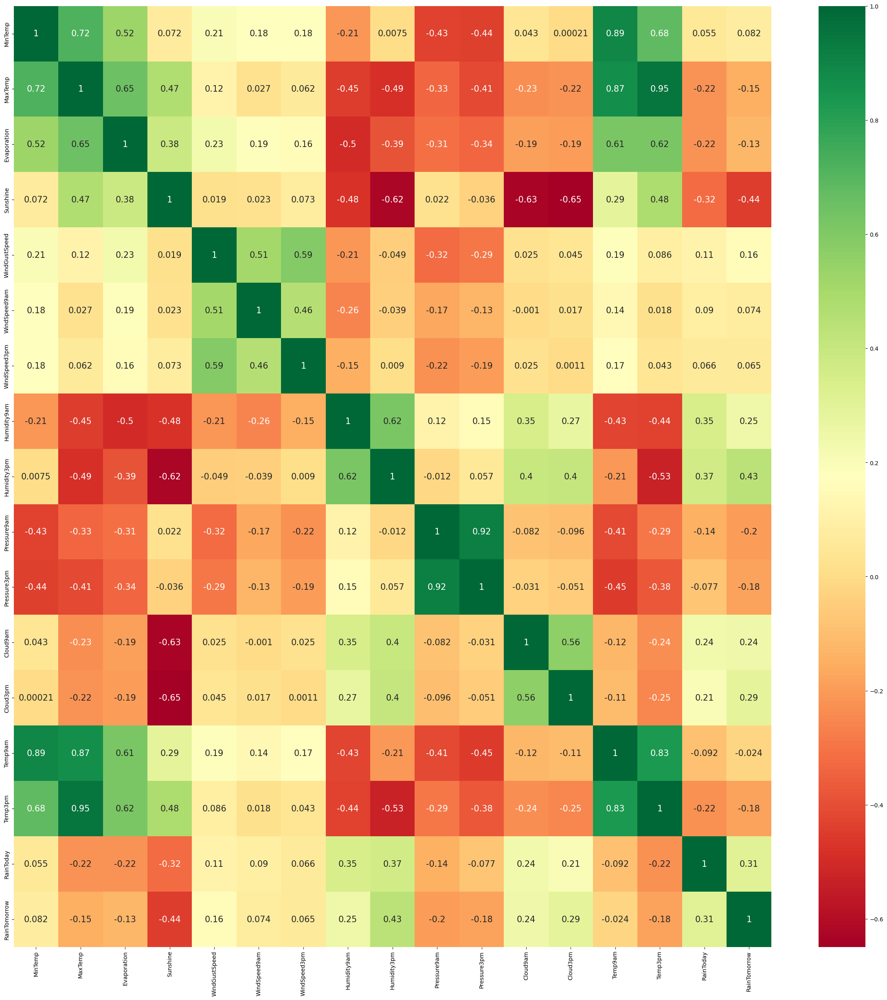

In [111]:
plt.figure(figsize=(30, 30))
sns.heatmap(num_data1.corr(), annot=True, cmap="RdYlGn", annot_kws={"size":15})
plt.show()

## Removing unwanted columns

In [112]:
df.columns

Index(['Date', 'Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation',
       'Sunshine', 'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [113]:
df.drop(['Date','Location','Evaporation','Sunshine'], axis="columns", inplace=True)

In [114]:
df

,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,13.4,22.9,0.0,13,44.0,13,14,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,5.0,16.9,21.8,0,0
1,7.4,25.1,0.0,14,44.0,6,15,4.0,22.0,44.0,25.0,1010.6,1007.8,5.0,5.0,17.2,24.3,0,0
2,12.9,25.7,0.0,15,46.0,13,15,19.0,26.0,38.0,30.0,1007.6,1008.7,5.0,2.0,21.0,23.2,0,0
3,9.2,28.0,0.0,4,24.0,9,0,11.0,9.0,45.0,16.0,1017.6,1012.8,5.0,5.0,18.1,26.5,0,0
4,17.5,32.3,0.0,13,41.0,1,7,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,2.8,23.4,0.0,0,31.0,9,1,13.0,11.0,51.0,24.0,1024.6,1020.3,5.0,5.0,10.1,22.4,0,0
145456,3.6,25.3,0.0,6,22.0,9,3,13.0,9.0,56.0,21.0,1023.5,1019.1,5.0,5.0,10.9,24.5,0,0
145457,5.4,26.9,0.0,3,37.0,9,14,9.0,9.0,53.0,24.0,1021.0,1016.8,5.0,5.0,12.5,26.1,0,0
145458,7.8,27.0,0.0,9,28.0,10,3,13.0,7.0,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,0,0


In [115]:
num_data1.columns

Index(['MinTemp', 'MaxTemp', 'Evaporation', 'Sunshine', 'WindGustSpeed',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')

In [116]:
from sklearn.preprocessing import RobustScaler

scaler = RobustScaler()
df[['MinTemp', 'MaxTemp', 'Rainfall', 'WindGustDir',
       'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm',
       'RainToday', 'RainTomorrow']]=scaler.fit_transform(df[['MinTemp', 'MaxTemp', 'Rainfall',  'WindGustDir',
       'WindGustSpeed', 'WindDir9am', 'WindDir3pm', 'WindSpeed9am',
       'WindSpeed3pm', 'Humidity9am', 'Humidity3pm', 'Pressure9am',
       'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am', 'Temp3pm',
       'RainToday', 'RainTomorrow']])

df

,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,0.153846,0.029703,0.0,0.444444,0.384615,0.750,0.750,0.583333,0.454545,0.04,-1.071429,-1.302632,-1.038462,1.000000,0.0,0.021978,0.074468,0.0,0.0
1,-0.505495,0.247525,0.0,0.555556,0.384615,-0.125,0.875,-0.750000,0.272727,-1.04,-0.964286,-0.921053,-0.948718,0.000000,0.0,0.054945,0.340426,0.0,0.0
2,0.098901,0.306931,0.0,0.666667,0.538462,0.750,0.875,0.500000,0.636364,-1.28,-0.785714,-1.315789,-0.833333,0.000000,-1.5,0.472527,0.223404,0.0,0.0
3,-0.307692,0.534653,0.0,-0.555556,-1.153846,0.250,-1.000,-0.166667,-0.909091,-1.00,-1.285714,0.000000,-0.307692,0.000000,0.0,0.153846,0.574468,0.0,0.0
4,0.604396,0.960396,0.0,0.444444,0.153846,-0.750,-0.125,-0.500000,0.090909,0.48,-0.678571,-0.894737,-1.179487,0.666667,1.5,0.120879,0.914894,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,-1.010989,0.079208,0.0,-1.000000,-0.615385,0.250,-0.875,0.000000,-0.727273,-0.76,-1.000000,0.921053,0.653846,0.000000,0.0,-0.725275,0.138298,0.0,0.0
145456,-0.923077,0.267327,0.0,-0.333333,-1.307692,0.250,-0.625,0.000000,-0.909091,-0.56,-1.107143,0.776316,0.500000,0.000000,0.0,-0.637363,0.361702,0.0,0.0
145457,-0.725275,0.425743,0.0,-0.666667,-0.153846,0.250,0.750,-0.333333,-0.909091,-0.68,-1.000000,0.447368,0.205128,0.000000,0.0,-0.461538,0.531915,0.0,0.0
145458,-0.461538,0.435644,0.0,0.000000,-0.846154,0.375,-0.625,0.000000,-1.090909,-0.76,-1.000000,0.236842,0.166667,-0.666667,-1.5,-0.175824,0.521277,0.0,0.0


# Model Building

In [117]:
## Split data into x and y
x = df.drop('RainTomorrow', axis=1)
y = df.RainTomorrow

In [118]:
## training and testing data
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.20, random_state=42)

In [119]:
x_train

,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
111548,0.274725,-0.475248,0.0,0.444444,0.000000,-0.500,0.125,-1.083333,0.000000,0.96,0.000000,0.855263,0.935897,1.000000,0.0,-0.054945,0.000000,1.0
142528,1.384615,1.673267,0.0,0.000000,-0.615385,-0.500,-0.125,-0.333333,-0.181818,-0.72,-1.107143,-0.763158,-1.102564,-1.000000,-0.5,1.472527,1.925532,0.0
65304,0.296703,0.396040,0.0,0.111111,-0.692308,0.625,0.000,-0.500000,-0.727273,0.68,0.178571,0.078947,0.025641,0.666667,-1.0,0.065934,0.361702,0.0
40651,0.692308,0.396040,0.0,0.000000,-0.846154,1.000,0.250,-0.166667,0.272727,0.36,0.535714,-0.078947,0.166667,0.333333,0.0,0.692308,0.457447,0.0
97487,-0.065934,-0.326733,0.0,0.444444,-0.615385,0.625,0.375,0.000000,0.000000,-0.28,-0.178571,0.131579,0.243590,0.000000,0.0,-0.252747,-0.297872,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110268,-0.219780,-0.534653,0.0,0.444444,0.000000,0.625,0.250,-0.916667,-0.363636,-0.48,0.214286,1.263158,1.346154,0.666667,-2.0,-0.318681,-0.542553,0.0
119879,-0.472527,-0.148515,0.0,-1.000000,-0.307692,-0.375,0.250,0.166667,-0.909091,-0.04,-0.321429,1.197368,1.000000,-1.333333,-2.0,-0.483516,-0.106383,0.0
103694,-0.483516,-0.089109,0.0,0.000000,0.000000,-0.375,-0.750,-0.583333,-0.181818,0.60,-0.357143,0.460526,0.564103,-1.000000,-1.5,-0.329670,0.010638,0.0
131932,-0.351648,-0.772277,0.0,-0.444444,1.307692,-0.500,-0.375,0.500000,0.818182,-0.56,0.357143,0.000000,0.000000,-0.666667,1.0,-0.285714,-0.797872,0.0


In [120]:
y_train

111548    1.0
142528    0.0
65304     0.0
40651     0.0
97487     0.0
         ... 
110268    0.0
119879    0.0
103694    0.0
131932    0.0
121958    0.0
Name: RainTomorrow, Length: 116368, dtype: float64

In [121]:
x_test

,MinTemp,MaxTemp,Rainfall,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday
100721,0.329670,-0.366337,0.0,-0.333333,1.153846,-0.125,-0.125,0.916667,1.090909,0.12,0.428571,-1.631579,-1.474359,-0.333333,0.0,0.065934,-0.372340,1.0
30234,0.120879,0.415842,0.0,0.444444,0.000000,0.750,0.750,0.750000,-0.363636,-0.36,-1.071429,-0.605263,-0.794872,-1.666667,-2.0,0.021978,0.510638,0.0
68427,0.769231,0.633663,0.0,-0.666667,1.538462,-0.500,-0.625,0.000000,0.272727,-0.80,-0.500000,-1.460526,-1.512821,0.000000,0.0,0.824176,0.648936,0.0
28624,0.670330,0.950495,0.0,-0.555556,-0.692308,-0.500,-0.500,-1.083333,-0.181818,1.16,-0.035714,0.210526,-0.076923,0.000000,0.0,0.461538,1.117021,0.0
31173,0.208791,-0.297030,0.0,0.222222,0.846154,0.625,0.000,0.333333,0.272727,0.80,0.428571,0.000000,0.410256,0.666667,0.5,-0.131868,-0.212766,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
57136,-0.131868,-0.287129,0.0,-0.666667,0.307692,-0.375,-0.375,0.750000,0.090909,-0.56,0.571429,-0.013158,-0.192308,0.000000,1.5,-0.043956,-0.414894,0.0
30386,-0.362637,-0.435644,0.0,0.444444,0.000000,0.875,0.250,0.500000,0.090909,0.00,0.357143,1.065789,0.910256,-1.000000,-0.5,-0.461538,-0.531915,0.0
17904,0.274725,0.257426,0.0,0.444444,0.000000,0.000,0.125,0.500000,0.000000,-0.24,0.000000,0.000000,0.000000,-0.333333,0.0,0.637363,0.000000,0.0
128313,0.076923,-0.198020,0.0,0.555556,-0.615385,-0.125,0.875,0.166667,-0.727273,0.88,1.107143,0.368421,0.666667,0.000000,0.0,-0.087912,-0.202128,0.0


In [122]:
y_test

100721    1.0
30234     0.0
68427     0.0
28624     0.0
31173     0.0
         ... 
57136     1.0
30386     0.0
17904     0.0
128313    0.0
80574     0.0
Name: RainTomorrow, Length: 29092, dtype: float64

In [123]:
## Balacing the data
from collections import Counter
from imblearn.over_sampling import SMOTE 
sm=SMOTE()
x_smote,y_smote=sm.fit_resample(x_train,y_train)

### Smote is used to balance the data so that overfitting and underfitting issues do not occur

In [124]:
print("actual",Counter(y_train))
print("after smote",Counter(y_smote))

actual Counter({0.0: 90911, 1.0: 25457})
after smote Counter({1.0: 90911, 0.0: 90911})


In [125]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

logistic_regression_model = LogisticRegression()
logistic_regression_model.fit(x_smote, y_smote)

logistic_regression_pred = logistic_regression_model.predict(x_test)

conf_matrix = confusion_matrix(y_test, logistic_regression_pred)
print("Confusion Matrix:")
print(conf_matrix)

accuracy = accuracy_score(y_test, logistic_regression_pred)
print("Accuracy:", accuracy)

precision = precision_score(y_test, logistic_regression_pred)
print("Precision:", precision)

recall = recall_score(y_test, logistic_regression_pred)
print("Recall:", recall)

f1 = f1_score(y_test, logistic_regression_pred)
print("F1 Score:", f1)


Confusion Matrix:
[[17542  5130]
 [ 1593  4827]]
Accuracy: 0.7689055410422109
Precision: 0.4847845736667671
Recall: 0.7518691588785047
F1 Score: 0.5894852537094706


In [126]:
from sklearn.tree import DecisionTreeClassifier
model=DecisionTreeClassifier() 
model.fit(x_smote,y_smote)
y_pred=model.predict(x_test)

In [127]:
y_train_predict=model.predict(x_train)
y_train_predict

array([1., 0., 0., ..., 0., 0., 0.])

In [128]:
# training accuracy
from sklearn.metrics import accuracy_score,classification_report,f1_score
accuracy_score(y_train,y_train_predict)

0.9998539117283102

In [129]:
# testing accuracy
accuracy_score(y_test,y_pred)

0.7638526055272927

In [130]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

random_forest_model = RandomForestClassifier()
random_forest_model.fit(x_smote, y_smote)

random_forest_pred = random_forest_model.predict(x_test)

conf_matrix = confusion_matrix(y_test, random_forest_pred)
print("Confusion Matrix:")
print(conf_matrix)

accuracy = accuracy_score(y_test, random_forest_pred)
print("Accuracy:", accuracy)

precision = precision_score(y_test, random_forest_pred)
print("Precision:", precision)

recall = recall_score(y_test, random_forest_pred)
print("Recall:", recall)

f1 = f1_score(y_test, random_forest_pred)
print("F1 Score:", f1)


Confusion Matrix:
[[20453  2219]
 [ 2524  3896]]
Accuracy: 0.8369654887941702
Precision: 0.6371218315617334
Recall: 0.6068535825545172
F1 Score: 0.6216194654966095


In [131]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.metrics import confusion_matrix, accuracy_score, precision_score, recall_score, f1_score

gradient_boosting_model = GradientBoostingClassifier()
gradient_boosting_model.fit(x_smote, y_smote)

gradient_boosting_pred = gradient_boosting_model.predict(x_test)

conf_matrix = confusion_matrix(y_test, gradient_boosting_pred)
print("Confusion Matrix:")
print(conf_matrix)

accuracy = accuracy_score(y_test, gradient_boosting_pred)
print("Accuracy:", accuracy)

precision = precision_score(y_test, gradient_boosting_pred)
print("Precision:", precision)

recall = recall_score(y_test, gradient_boosting_pred)
print("Recall:", recall)

f1 = f1_score(y_test, gradient_boosting_pred)
print("F1 Score:", f1)


Confusion Matrix:
[[19343  3329]
 [ 2155  4265]]
Accuracy: 0.8114945689536642
Precision: 0.5616276007374242
Recall: 0.6643302180685359
F1 Score: 0.6086770372484658


In [145]:
from sklearn.neighbors import KNeighborsClassifier
KNN=KNeighborsClassifier(n_neighbors=2)
KNN.fit(x_smote,y_smote)
y_pred=KNN.predict(x_test)
accuracy_score(y_test,y_pred)

0.786711123332875

In [138]:
error_rate=[]
for k in range(1,11):
  KNN=KNeighborsClassifier(n_neighbors=k)
  KNN.fit(x_smote,y_smote)
  y_pred=KNN.predict(x_test)
  error_rate.append(np.mean(y_pred!=y_test))
error_rate

[0.23174755946652,
 0.21328887666712498,
 0.24986250515605665,
 0.2271414821944177,
 0.25457170356111647,
 0.23339749759384024,
 0.25391860305238556,
 0.23271002337412347,
 0.25292176543379624,
 0.23490994087721712]

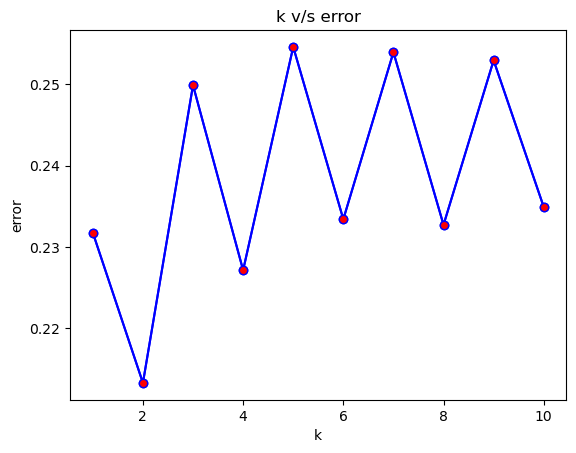

In [140]:
plt.plot(range(1,11),error_rate,color='blue',marker="o",markerfacecolor='red')
plt.xlabel("k")
plt.ylabel("error")
plt.title("k v/s error")
plt.show()

In [150]:
from sklearn.ensemble import BaggingClassifier
model_bag=BaggingClassifier(estimator=random_forest_model,n_estimators=5)
model_bag.fit(x_smote,y_smote)
y_pred=model_bag.predict(x_test)
accuracy_score(y_test,y_pred)

0.8321875429671387